# Comaprison between DNA-RNA vs. MERFISH only

data1: 20210529

data2: 20210717

In [68]:
import numpy as np
import pandas as pd
import seaborn as sns
import anndata
import scanpy as sc
import os
sns.set_style("dark")
sc.settings.n_jobs = 24
sc.settings.set_figure_params(dpi=180, dpi_save=300, frameon=False, figsize=(4, 4), fontsize=8, facecolor='white')

In [52]:
figure_folder = r'\\10.245.74.40\Turing1.5\Pu\MERFISH_Analysis\Figures\20210922-Compare_DNA-RNA'

## Data 1

In [3]:
merlin_output_folder = r'J:\MERFISH_Analysis\20210529-P_Forebrain_MERFISH4_CTP09_exp2'

cell_meta_data_file = os.path.join(merlin_output_folder, 'ExportCellMetadata', 'feature_metadata.csv')
cell_meta_data = pd.read_csv(cell_meta_data_file)
# Load MERFISH data
counts_file_mer = os.path.join(merlin_output_folder, 'ExportPartitionedBarcodes', 'barcodes_per_feature.csv')
df = pd.read_csv(counts_file_mer).rename(columns={'Unnamed: 0':'index'}).set_index('index')
#blanks = [f'Blank-{i}' for i in range(1, 11)]
for _c in df.columns:
    if 'Blank-' in _c:
        df = df.drop(columns=_c)
data1 = anndata.AnnData(df)
data1.obs = data1.obs.merge(cell_meta_data, left_index=True, right_on='Unnamed: 0').set_index('Unnamed: 0')

## Data 2

In [8]:
merlin_output_folder = r'J:\MERFISH_Analysis\20210717-P_brain_MO4_MERFISH_renamed_data_full'

cell_meta_data_file = os.path.join(merlin_output_folder, 'ExportCellMetadata', 'feature_metadata.csv')
cell_meta_data = pd.read_csv(cell_meta_data_file)
# Load MERFISH data
counts_file_mer = os.path.join(merlin_output_folder, 'ExportPartitionedBarcodes', 'barcodes_per_feature.csv')
df = pd.read_csv(counts_file_mer).rename(columns={'Unnamed: 0':'index'}).set_index('index')
#blanks = [f'Blank-{i}' for i in range(1, 11)]
for _c in df.columns:
    if 'Blank-' in _c:
        df = df.drop(columns=_c)
data2 = anndata.AnnData(df)
data2.obs = data2.obs.merge(cell_meta_data, left_index=True, right_on='Unnamed: 0').set_index('Unnamed: 0')

In [4]:
data1.var


""
1810046K07Rik
5031425F14Rik
Acta2
Adam2
Adamts2
...
Ust
Vipr2
Vwc2
Wnt7b


In [12]:
for _gname in data2.to_df:
    print(_gname)

In [16]:
# Calculate quality control metrics
sc.pp.calculate_qc_metrics(data2, percent_top=None, log1p=False, inplace=True)

In [28]:
data1_df = data1.to_df()
data2_df = data2.to_df()

# generate scatterplot
data1_mean_cts, data2_mean_cts = [],[]
overlap_gene_names = []

for _col in data2_df.columns:
    if _col in data1_df.columns:
        print(np.mean(data1_df[_col]), np.mean(data2_df[_col]))
        overlap_gene_names.append(_col)
        data1_mean_cts.append(np.mean(data1_df[_col]))
        data2_mean_cts.append(np.mean(data2_df[_col]))

0.0310118 0.11835211
0.08081863 0.056588944
0.8575754 1.2828792
0.03884306 0.16380665
0.050537746 0.5231202
0.1283283 5.075714
0.022031952 1.1095756
0.04291532 0.23185748
0.08541297 5.0539036
0.14555706 2.1919045
0.030176464 0.56281114
0.07852146 0.610951
0.048031744 0.3851192
0.056907173 1.2807178
0.085935056 0.54381716
0.0626501 2.6495285
0.14305106 5.974391
0.08165396 0.6090516
0.6965647 0.38721508
0.04876266 0.32951272
0.07538895 0.6056458
0.16059309 0.13839403
0.09877832 0.296437
0.1551634 0.2332329
0.17385402 5.410532
0.094810486 7.1803775
0.07309178 3.127849
0.038425393 0.1277181
0.052521665 0.17736442
0.14879398 1.3260413
0.050328914 0.9301153
0.05993526 2.8660598
0.04385507 0.06163217
0.10086666 1.7272727
0.11652918 1.2551743
0.1724966 0.52901495
0.10848909 0.8148415
0.04938916 0.4440005
0.15662524 2.6452057
0.08572622 1.3811239
0.10817584 0.19557244
0.09073823 0.89507467
0.055863004 1.2519649
0.09146915 5.9174743
0.08269813 3.3702514
0.024537956 0.06274561
0.07873029 0.024168

In [30]:
data1_mean_cts

[0.0310118,
 0.08081863,
 0.8575754,
 0.03884306,
 0.050537746,
 0.1283283,
 0.022031952,
 0.04291532,
 0.08541297,
 0.14555706,
 0.030176464,
 0.07852146,
 0.048031744,
 0.056907173,
 0.085935056,
 0.0626501,
 0.14305106,
 0.08165396,
 0.6965647,
 0.04876266,
 0.07538895,
 0.16059309,
 0.09877832,
 0.1551634,
 0.17385402,
 0.094810486,
 0.07309178,
 0.038425393,
 0.052521665,
 0.14879398,
 0.050328914,
 0.05993526,
 0.04385507,
 0.10086666,
 0.11652918,
 0.1724966,
 0.10848909,
 0.04938916,
 0.15662524,
 0.08572622,
 0.10817584,
 0.09073823,
 0.055863004,
 0.09146915,
 0.08269813,
 0.024537956,
 0.07873029,
 0.07204761,
 0.03623264,
 0.072256446,
 0.29362014,
 0.11297901,
 0.09856949,
 0.106714,
 0.1364728,
 0.16027984,
 0.101702,
 0.43719327,
 0.051373083,
 0.07392712,
 0.030072048,
 1.1652918,
 0.25550798,
 0.0837423,
 0.12519579,
 0.043228567,
 0.12989454,
 0.16842435,
 0.18283388,
 0.041035816,
 0.030176464,
 0.13908322,
 0.09032056,
 0.111621596,
 0.079043545,
 0.13918763,
 0.071

In [36]:
from scipy.stats import linregress, pearsonr
lr_combined = linregress(data2_mean_cts,
                         data1_mean_cts)
print(lr_combined)
print('pearson correlation:', np.abs(lr_combined.rvalue))

LinregressResult(slope=0.004505483628277177, intercept=0.11943627218196003, rvalue=0.08922500023997285, pvalue=0.25885207536694593, stderr=0.00397611757109322)
pearson correlation: 0.08922500023997285


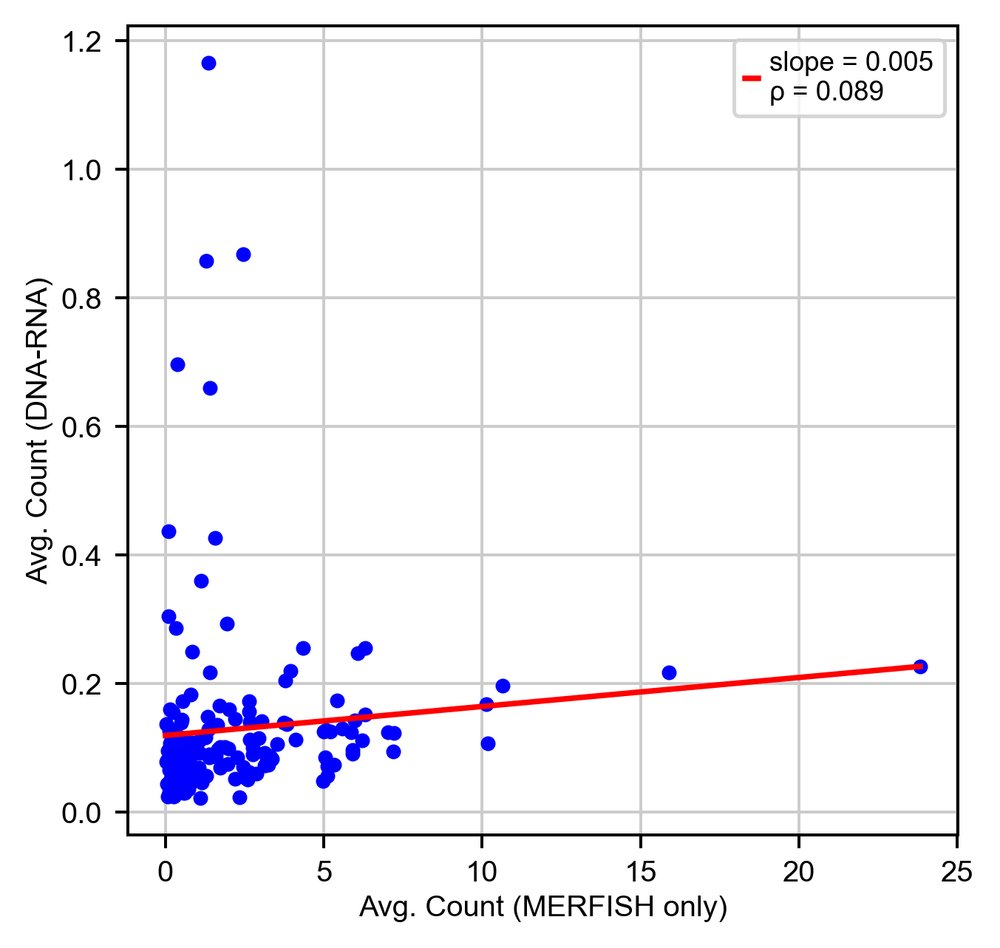

In [53]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots()
ax.plot(data2_mean_cts, data1_mean_cts, 'b.')

reg_x = np.linspace(0, max(data2_mean_cts), 100)
reg_y = lr_combined.slope * reg_x + lr_combined.intercept

ax.plot(reg_x, reg_y, 'r', label=f'slope = {lr_combined.slope:.3f}\n\u03C1 = {lr_combined.rvalue:.3f}')

#plt.axis('equal')
ax.set_ylabel('Avg. Count (DNA-RNA)', labelpad=2)
ax.set_xlabel('Avg. Count (MERFISH only)', labelpad=2)

ax.legend()
plt.savefig(os.path.join(figure_folder, 
                         'Scatter_avg_count.png'), 
            transparent=False)

plt.show()

In [160]:
import skimage.io as skio
from scipy.stats import scoreatpercentile
from mpl_toolkits.axes_grid1 import make_axes_locatable

data_folder = r'J:\MERFISH_Analysis\20210529-P_Forebrain_MERFISH4_CTP09_exp2_test'
imstack1 = skio.imread(os.path.join(data_folder,
                                    r'FiducialCorrelationWarp\images\aligned_images0.tif'), 
                       plugin="tifffile")
data_organization_df = pd.read_csv(os.path.join(data_folder, 'dataorganization.csv'))

ims1 = []
for _i in range(int(len(imstack1)/8)):
    ims1.append(imstack1[_i*8:(_i+1)*8])

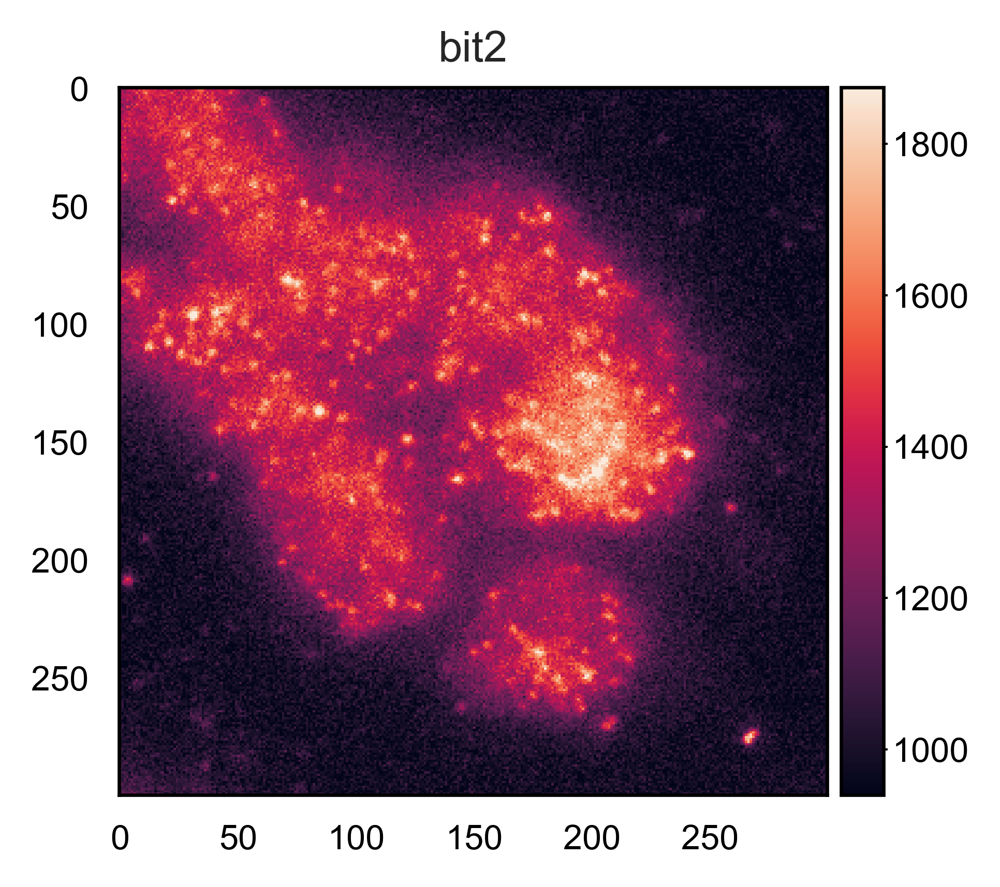

In [183]:
# select crop
sel_crop=(slice(700,1000), slice(400,700))
sel_layer = 3
sel_round = 1
fig, ax = plt.subplots(figsize=(4,3), dpi=300)
_im_layer = ims1[sel_round][sel_layer][sel_crop]
_pf = ax.imshow(_im_layer, 
                vmin=scoreatpercentile(_im_layer, 5),
                vmax=scoreatpercentile(_im_layer, 99.9))
ax.grid(False)

divider = make_axes_locatable(ax)
cax = divider.append_axes('right', size='6%', pad="2%")
cb = plt.colorbar(_pf, cax=cax, orientation='vertical', 
                  extend='neither', 
                  )
cb.ax.minorticks_off()
cb.ax.tick_params(labelsize=8, width=0.5, length=1,pad=1)
[i[1].set_linewidth(0.5) for i in cb.ax.spines.items()]

ax.set_title(f"{data_organization_df['channelName'][sel_round]}", fontsize=10)

plt.savefig(os.path.join(figure_folder, 
                         f"Data1_example_image_{data_organization_df['channelName'][sel_round]}.png"),
            transparent=True,)

plt.show()

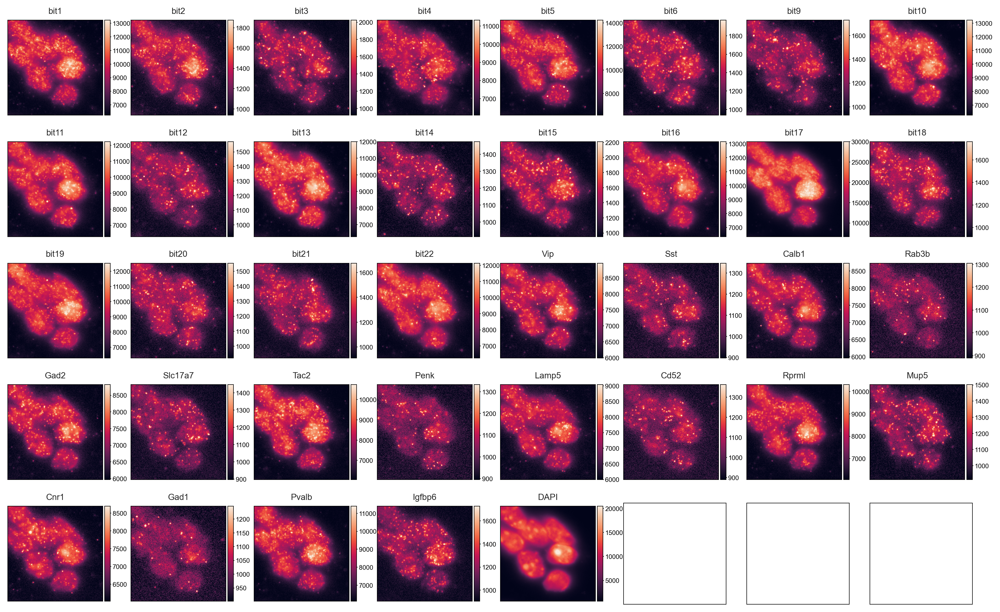

In [170]:
fig, axes = plt.subplots(5,8, figsize=(8*2,5*2), dpi=150)
_i = 0
for _ix, ax_row in enumerate(axes):
    for _iy, ax in enumerate(ax_row):
        # default settings
        ax.grid(False)
        [i[1].set_linewidth(0.5) for i in ax.spines.items()]
        ax.tick_params('both', labelsize=7, 
                       width=0.5, length=1,
                       pad=1, labelbottom=False, labelleft=False)
        
        
        if _i >= len(ims1):
            continue
            
        _im_layer = ims1[_i][3][sel_crop]
        _pf = ax.imshow(_im_layer, 
                        vmin=scoreatpercentile(_im_layer, 5),
                        vmax=scoreatpercentile(_im_layer, 99.9))
        ax.grid(False)
        ax.set_title(f"{data_organization_df['channelName'][_i]}")
        [i[1].set_linewidth(0.5) for i in ax.spines.items()]
        ax.tick_params('both', labelsize=7, 
                       width=0.5, length=1,
                       pad=1, labelbottom=False, labelleft=False)
        
        divider = make_axes_locatable(ax)
        cax = divider.append_axes('right', size='6%', pad="2%")
        cb = plt.colorbar(_pf, cax=cax, orientation='vertical', 
                          extend='neither', 
                          )
        cb.ax.minorticks_off()
        cb.ax.tick_params(labelsize=6, width=0.5, length=1,pad=1)
        [i[1].set_linewidth(0.5) for i in cb.ax.spines.items()]
        cb.outline.set_linewidth(0.5)
        
        _i += 1

plt.savefig(os.path.join(figure_folder, 
                         f"Data1_example_image.png"),
            transparent=True,)

plt.show()

# data2

In [171]:

import skimage.io as skio
from scipy.stats import scoreatpercentile
from mpl_toolkits.axes_grid1 import make_axes_locatable

data_folder = r'J:\MERFISH_Analysis\20210717-P_brain_MO4_MERFISH_renamed_data_full'
imstack2 = skio.imread(os.path.join(data_folder,
                                    r'FiducialCorrelationWarp\images\aligned_images4.tif'), 
                       plugin="tifffile")
data_organization_df = pd.read_csv(os.path.join(data_folder, 'dataorganization.csv'))

ims2 = list(imstack2)
#for _i in range(int(len(imstack2)/8)):
#    ims.append(imstack2[_i*8:(_i+1)*8])

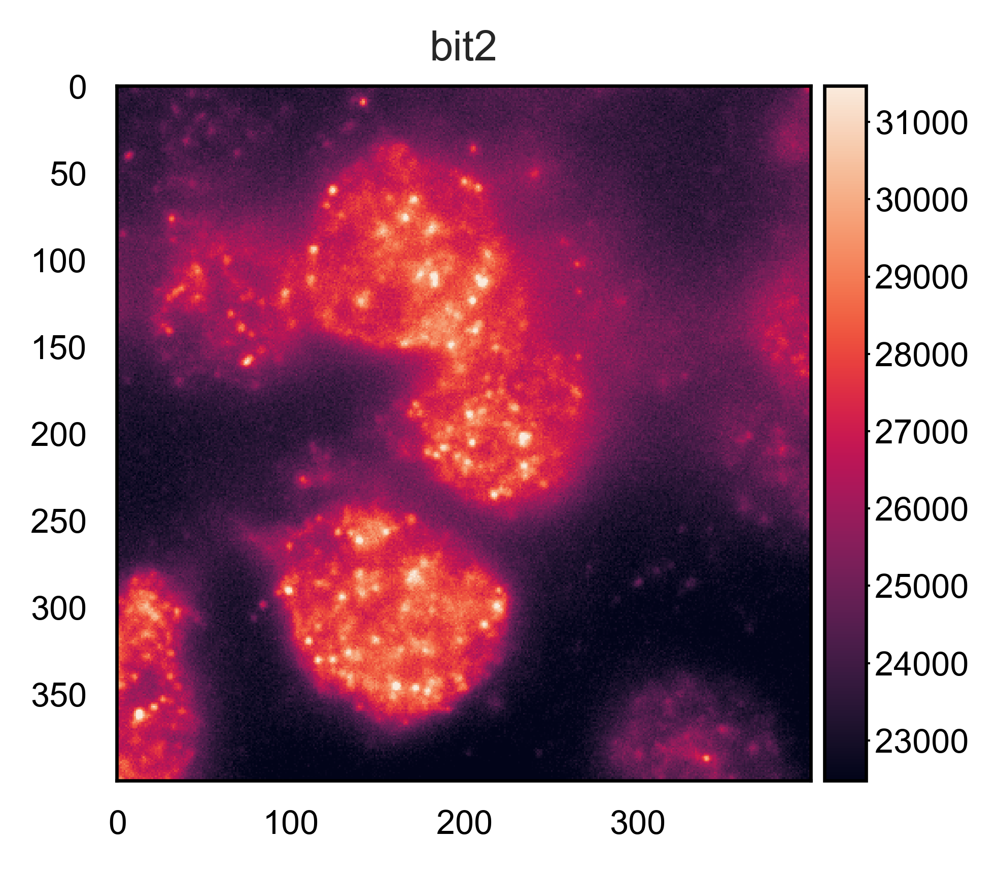

In [182]:
# select crop
sel_crop=(slice(400,800), slice(900,1300))
sel_layer = 6
sel_round = 1
fig, ax = plt.subplots(figsize=(4,3), dpi=300)
_im_layer = ims2[sel_round][sel_layer][sel_crop]
_pf = ax.imshow(_im_layer, 
                vmin=scoreatpercentile(_im_layer, 5),
                vmax=scoreatpercentile(_im_layer, 99.9))
ax.grid(False)

divider = make_axes_locatable(ax)
cax = divider.append_axes('right', size='6%', pad="2%")
cb = plt.colorbar(_pf, cax=cax, orientation='vertical', 
                  extend='neither', 
                  )
cb.ax.minorticks_off()
cb.ax.tick_params(labelsize=8, width=0.5, length=1,pad=1)
[i[1].set_linewidth(0.5) for i in cb.ax.spines.items()]

ax.set_title(f"{data_organization_df['channelName'][sel_round]}", fontsize=10)

plt.savefig(os.path.join(figure_folder, 
                         f"Data2_example_image_{data_organization_df['channelName'][sel_round]}.png"),
            transparent=True,)

plt.show()

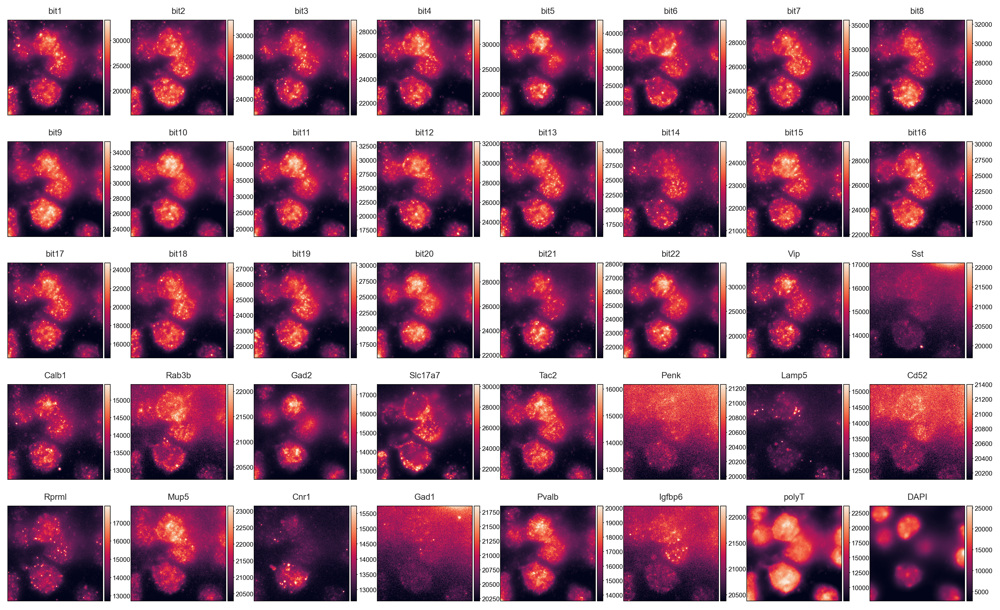

In [180]:
fig, axes = plt.subplots(5,8, figsize=(8*2,5*2), dpi=150)
_i = 0
for _ix, ax_row in enumerate(axes):
    for _iy, ax in enumerate(ax_row):
        # default settings
        ax.grid(False)
        [i[1].set_linewidth(0.5) for i in ax.spines.items()]
        ax.tick_params('both', labelsize=7, 
                       width=0.5, length=1,
                       pad=1, labelbottom=False, labelleft=False)
        
        
        if _i >= len(ims2):
            continue
            
        _im_layer = ims2[_i][sel_layer][sel_crop]
        _pf = ax.imshow(_im_layer, 
                        vmin=scoreatpercentile(_im_layer, 5),
                        vmax=scoreatpercentile(_im_layer, 99.9))
        ax.grid(False)
        ax.set_title(f"{data_organization_df['channelName'][_i]}")
        [i[1].set_linewidth(0.5) for i in ax.spines.items()]
        ax.tick_params('both', labelsize=7, 
                       width=0.5, length=1,
                       pad=1, labelbottom=False, labelleft=False)
        
        divider = make_axes_locatable(ax)
        cax = divider.append_axes('right', size='6%', pad="2%")
        cb = plt.colorbar(_pf, cax=cax, orientation='vertical', 
                          extend='neither', 
                          )
        cb.ax.minorticks_off()
        cb.ax.tick_params(labelsize=6, width=0.5, length=1,pad=1)
        [i[1].set_linewidth(0.5) for i in cb.ax.spines.items()]
        cb.outline.set_linewidth(0.5)
        
        _i += 1

plt.savefig(os.path.join(figure_folder, 
                         f"Data2_example_image.png"),
            transparent=True,)

plt.show()